<a href="https://colab.research.google.com/github/VishwassKhattarr/Image-Processing/blob/main/CompVis.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import numpy as np
import cv2 as cv

img = cv.imread('teddy (4).jpg')
assert img is not None, "file could not be read, check with os.path.exists()"

In [ ]:
from google.colab import files
uploaded = files.upload()

Saving teddy.jpg to teddy (4).jpg


In [ ]:
px = img[100,100]
print( px )
blue = img[100,100,1]
print( blue )

[175 200 226]
200


In [ ]:
print( img.shape )

(1000, 1000, 3)


In [ ]:
ball = img[280:500, 330:600]
img[273:493, 100:370] = ball

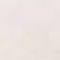

In [ ]:
from google.colab.patches import cv2_imshow
cv2_imshow(ball)

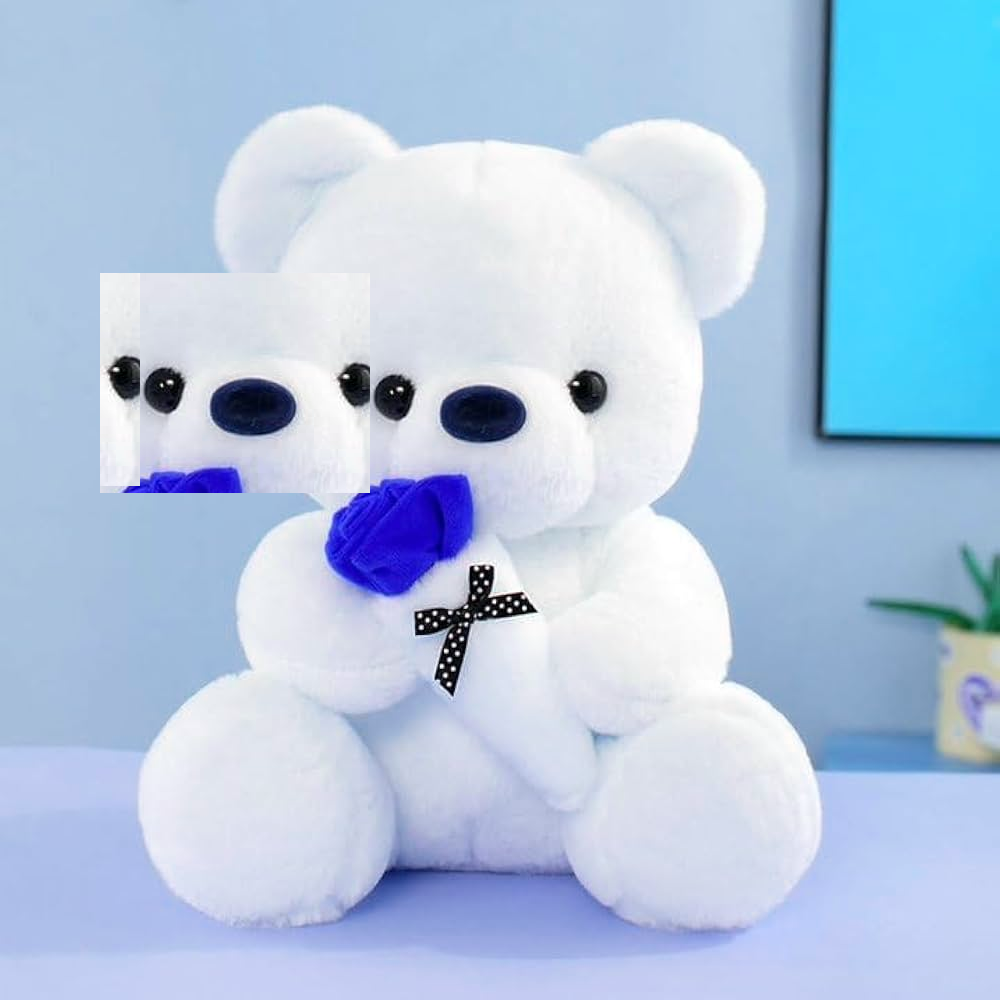

In [ ]:
b,g,r = cv.split(img)
# img = cv.merge((b,g,r))
from google.colab.patches import cv2_imshow
new=cv.merge((r,g,b))
cv2_imshow(new)

In [ ]:
from google.colab.patches import cv2_imshow
m=img[:,:,200]
cv2_imshow(m)

IndexError: index 200 is out of bounds for axis 2 with size 3

22/08/2025


take 2 images
in a loop use alpha from 0-1, 0.1,0.2,0.3.....0.9
generate 9-10 images which are a resultant
mat.lib for plot


perform image subtraction


bitwise operations


simple thresholding of images-take a grey image, levels 0 to 255, set 128 as th val, all pictures below 128 converted to 0 rest convert to 1



In [ ]:
import numpy as np
import cv2 as cv
from google.colab.patches import cv2_imshow

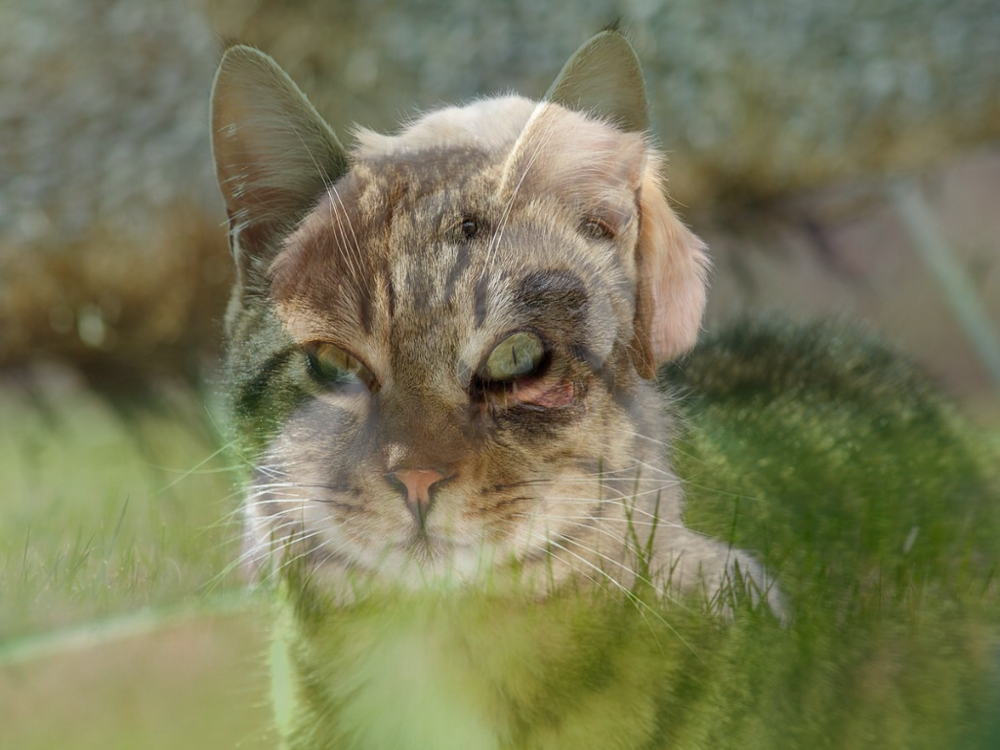

In [ ]:
img1 = cv.imread('dog.jpg')
img2 = cv.imread('cat.jpg')
assert img1 is not None, "file could not be read, check with os.path.exists()"
assert img2 is not None, "file could not be read, check with os.path.exists()"

# Get the dimensions of the first image
height, width, _ = img1.shape

# Resize the second image to match the dimensions of the first image
img2_resized = cv.resize(img2, (width, height))

dst = cv.addWeighted(img1,0.5,img2_resized,0.5,0)

# Use cv2_imshow for displaying images in Colab
from google.colab.patches import cv2_imshow
cv2_imshow(dst)

# cv.waitKey(0)
# cv.destroyAllWindows()

Images have different dimensions. Resizing img2 to match img1.


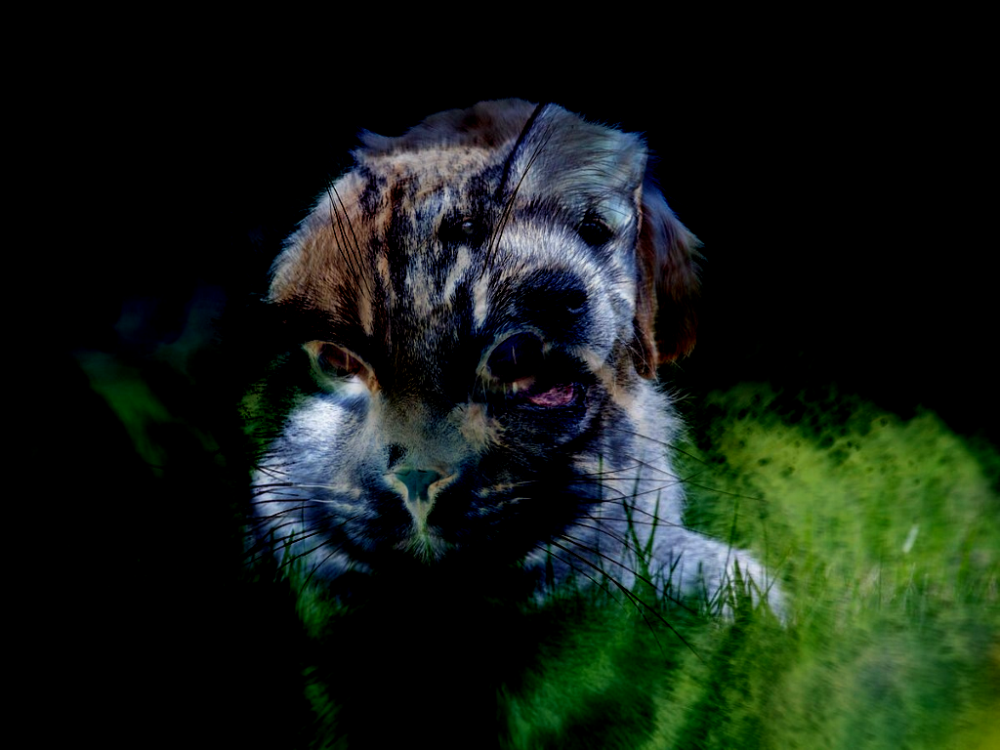

In [ ]:
import cv2 as cv
from google.colab.patches import cv2_imshow
import numpy as np

# Load two images (make sure they are the same size)
# You can use the images you've already uploaded or upload new ones
img1 = cv.imread('dog.jpg')
img2 = cv.imread('cat.jpg')

assert img1 is not None, "file 1 could not be read, check with os.path.exists()"
assert img2 is not None, "file 2 could not be read, check with os.path.exists()"

# Ensure images are the same size for subtraction
# You might need to resize one if they are not
if img1.shape != img2.shape:
    print("Images have different dimensions. Resizing img2 to match img1.")
    img2 = cv.resize(img2, (img1.shape[1], img1.shape[0]))

# Perform image subtraction
# Note: Pixel values will be the difference. Negative values are set to 0.
subtracted_img = cv.subtract(img1, img2)

# Display the subtracted image
cv2_imshow(subtracted_img)

Images have different dimensions. Resizing img2 to match img1.


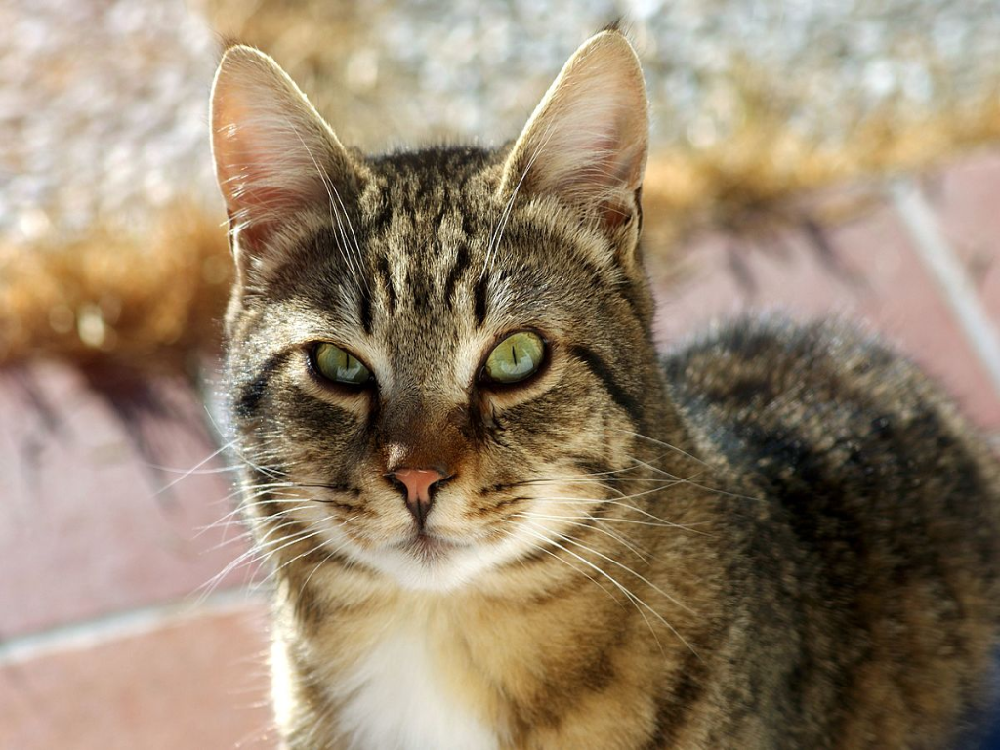

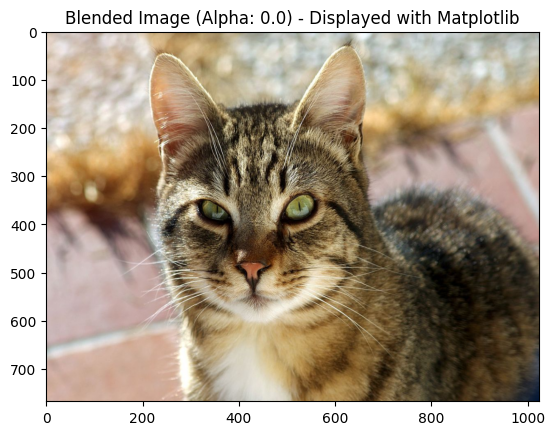

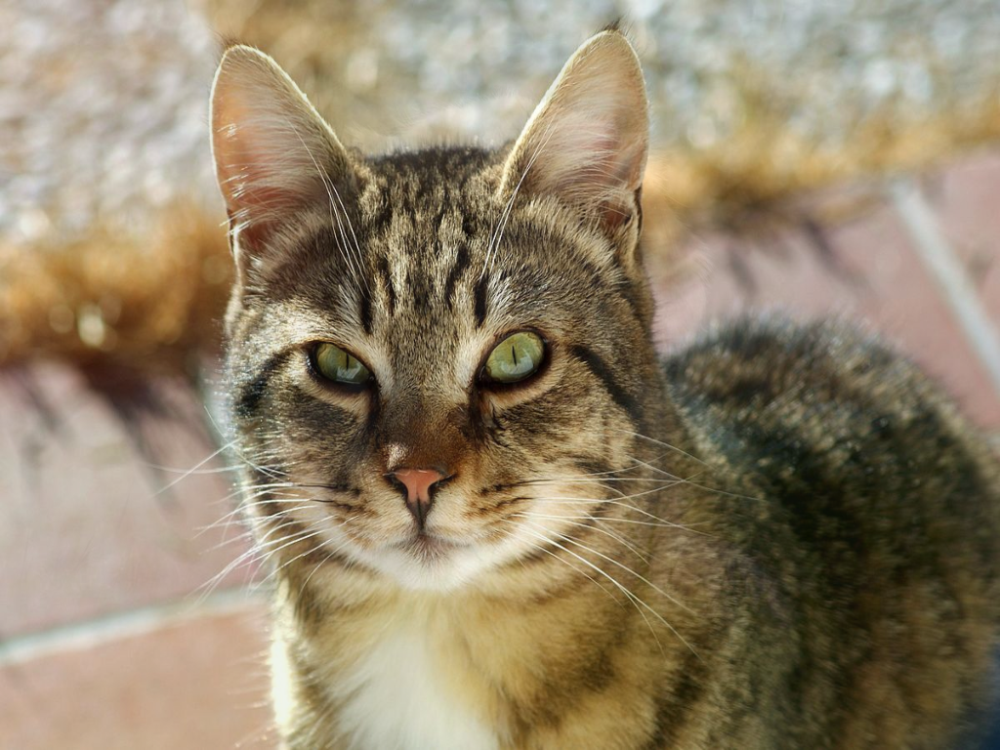

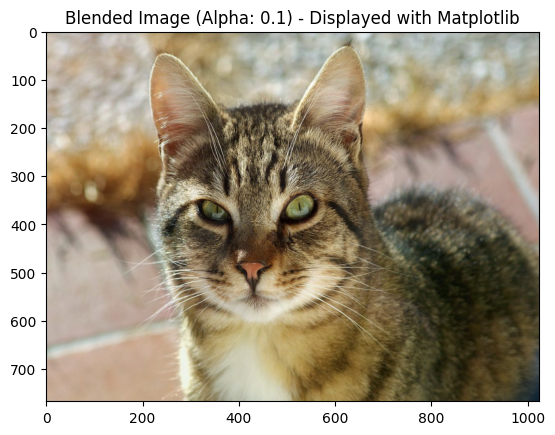

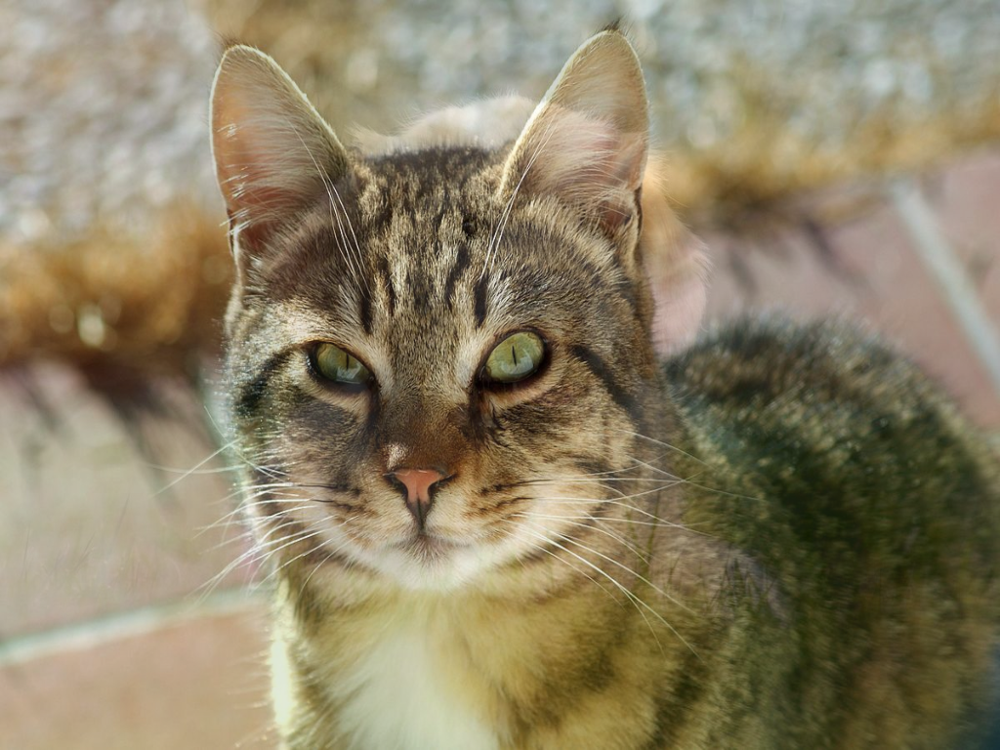

...

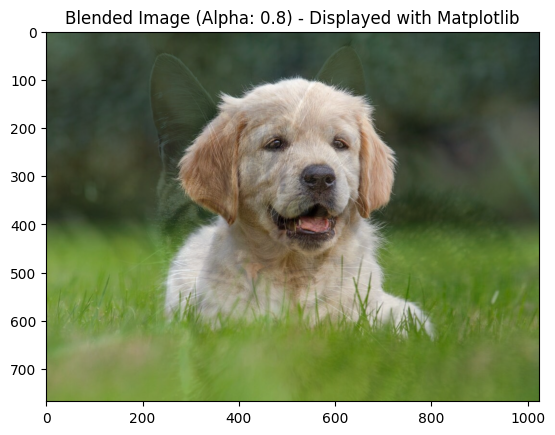

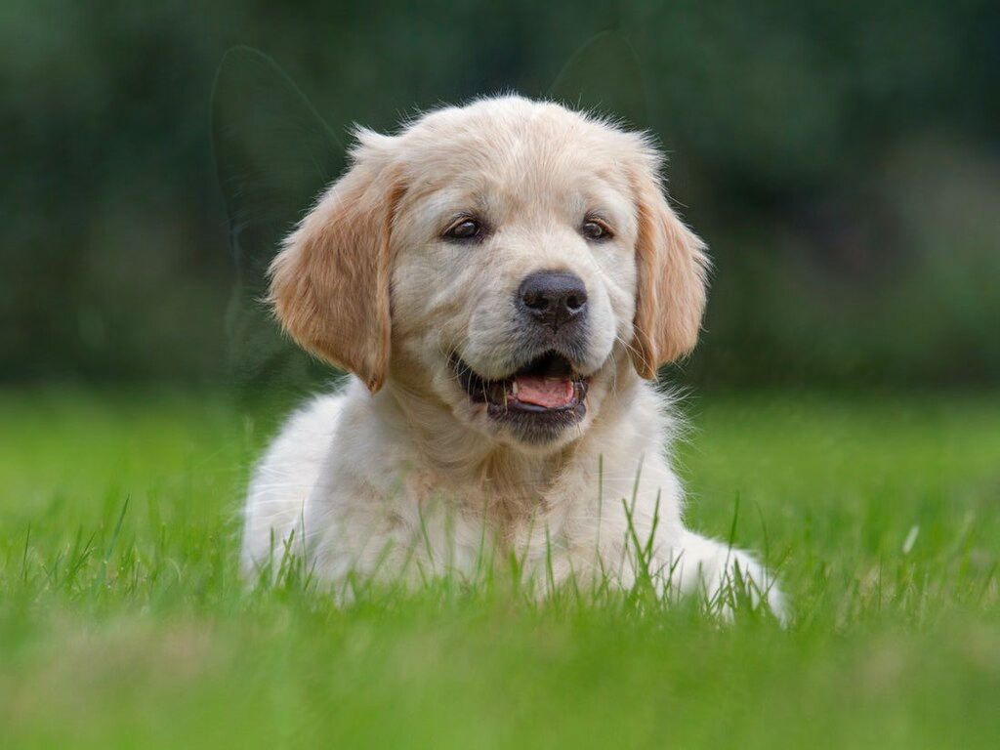

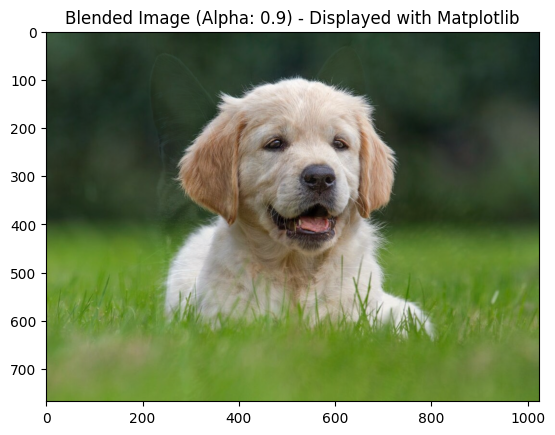

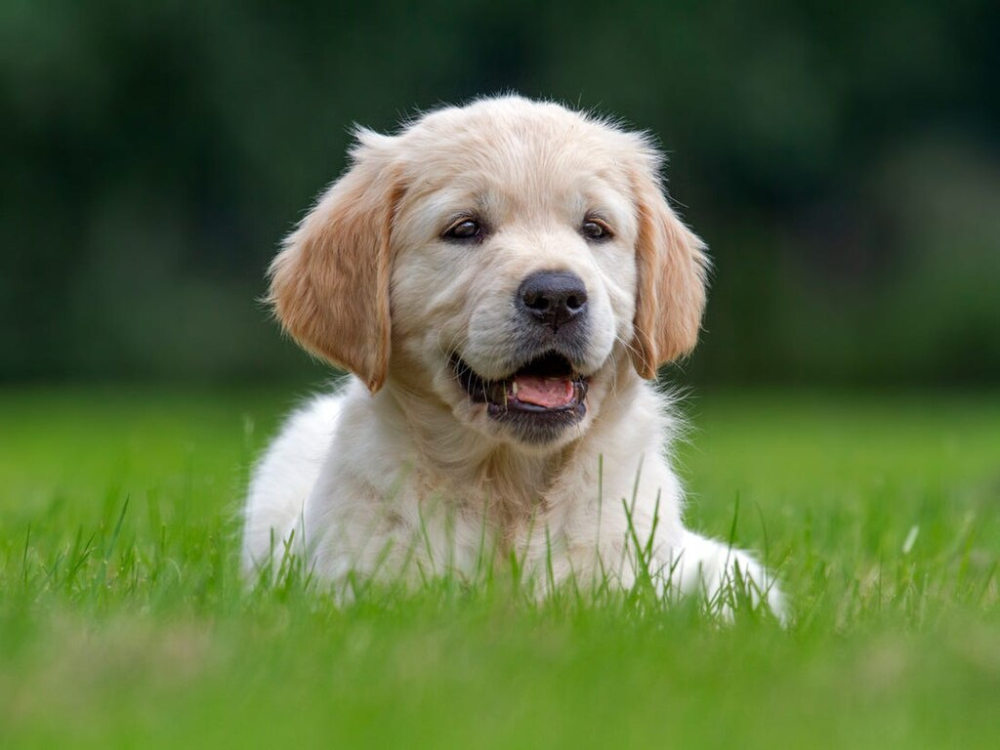

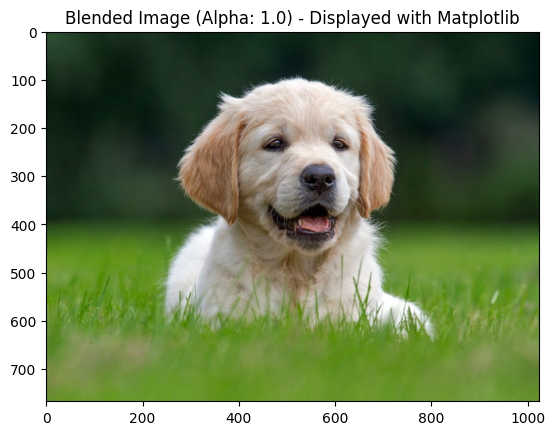

In [ ]:
import cv2 as cv
from google.colab.patches import cv2_imshow
import numpy as np
import matplotlib.pyplot as plt

# Load two images (make sure they are the same size or resize them)
img1 = cv.imread('dog.jpg')
img2 = cv.imread('cat.jpg')

assert img1 is not None, "file 1 could not be read, check with os.path.exists()"
assert img2 is not None, "file 2 could not be read, check with os.path.exists()"

# Ensure images are the same size
if img1.shape != img2.shape:
    print("Images have different dimensions. Resizing img2 to match img1.")
    img2 = cv.resize(img2, (img1.shape[1], img1.shape[0]))

# List to store blended images
blended_images = []
alpha_values = np.arange(0, 1.1, 0.1)

# Loop through alpha values from 0 to 1 with a step of 0.1
for alpha in alpha_values:
    # Calculate beta
    beta = 1 - alpha

    # Perform weighted addition
    blended_img = cv.addWeighted(img1, alpha, img2, beta, 0)

    # Append the blended image to the list
    blended_images.append(blended_img)

    # Optional: Display images within the loop using cv2_imshow if you prefer
    # print(f"Alpha: {alpha:.1f}, Beta: {beta:.1f}")
    cv2_imshow(blended_img)
    blended_img_rgb = cv.cvtColor(blended_img, cv.COLOR_BGR2RGB)

# Display the image using matplotlib
    plt.imshow(blended_img_rgb)
    plt.title(f'Blended Image (Alpha: {alpha:.1f}) - Displayed with Matplotlib') # Added a more descriptive title
# plt.axis('off') # Removed to show coordinates
    plt.show()

# Now, we'll use matplotlib to plot all the collected images in a grid in the next cell.

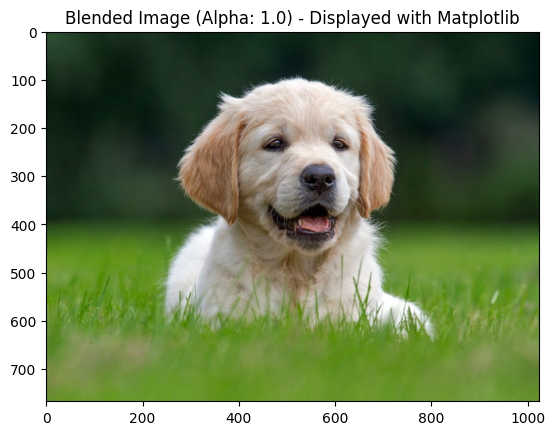

In [ ]:
import matplotlib.pyplot as plt
import cv2 as cv
import numpy as np

# Assuming 'blended_img' is one of the images generated in your loop
# It's the last image from the loop in cell ALDMb9nYGoB6 where alpha was 1.0

# Convert the blended image from BGR (OpenCV default) to RGB (Matplotlib default)
blended_img_rgb = cv.cvtColor(blended_img, cv.COLOR_BGR2RGB)

# Display the image using matplotlib
plt.imshow(blended_img_rgb)
plt.title(f'Blended Image (Alpha: {alpha:.1f}) - Displayed with Matplotlib') # Added a more descriptive title
# plt.axis('off') # Removed to show coordinates
plt.show()

29/08/2025
2d convulation
image filtering
smoothing image

In [4]:
from google.colab import files

# This will open a file picker in Colab
uploaded = files.upload()

# Show the uploaded file name
for filename in uploaded.keys():
    print(f'You uploaded file: {filename}')


Saving dog.jpg to dog.jpg
You uploaded file: dog.jpg


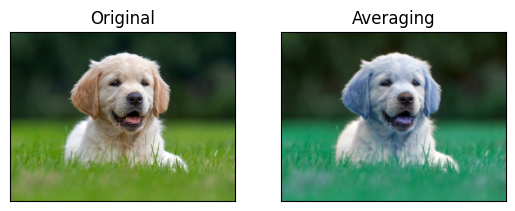

In [6]:
import numpy as np
import cv2 as cv
from matplotlib import pyplot as plt

img = cv.imread('dog.jpg')
assert img is not None, "file could not be read, check with os.path.exists()"

kernel = np.ones((5,5),np.float32)/25
dst = cv.filter2D(img,-1,kernel)
img_rgb = cv.cvtColor(img, cv.COLOR_BGR2RGB)
plt.subplot(121),plt.imshow(img_rgb),plt.title('Original')
plt.xticks([]), plt.yticks([])
plt.subplot(122),plt.imshow(dst),plt.title('Averaging')
plt.xticks([]), plt.yticks([])
plt.show()

In [3]:
import os
print(os.path.exists("dog.jpg"))

False


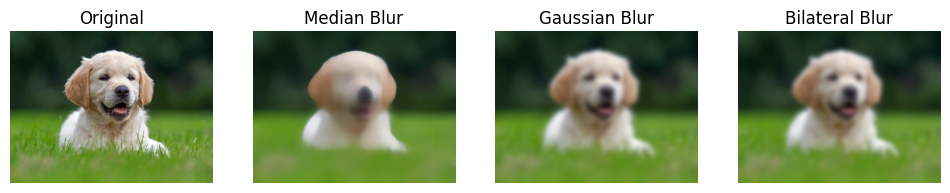

In [20]:
import cv2 as cv
import numpy as np
from matplotlib import pyplot as plt

img = cv.imread('dog.jpg')
assert img is not None, "file could not be read, check with os.path.exists()"

# Apply blurs
gaussian = cv.GaussianBlur(img, (71,71), 0)
median = cv.medianBlur(img, 71)
blur = cv.bilateralFilter(img,9,75,75)

# Convert to RGB for matplotlib
img_rgb = cv.cvtColor(img, cv.COLOR_BGR2RGB)
gaussian_rgb = cv.cvtColor(gaussian, cv.COLOR_BGR2RGB)
median_rgb = cv.cvtColor(median, cv.COLOR_BGR2RGB)
bilateral_blur=cv.cvtColor(blur, cv.COLOR_BGR2RGB)


# Plot images
plt.figure(figsize=(12,6))
plt.subplot(141), plt.imshow(img_rgb), plt.title('Original')
plt.axis('off')

plt.subplot(142), plt.imshow(median_rgb), plt.title('Median Blur')
plt.axis('off')

plt.subplot(143), plt.imshow(gaussian_rgb), plt.title('Gaussian Blur')
plt.axis('off')

plt.subplot(144), plt.imshow(gaussian_rgb), plt.title('Bilateral Blur')
plt.axis('off')

plt.show()


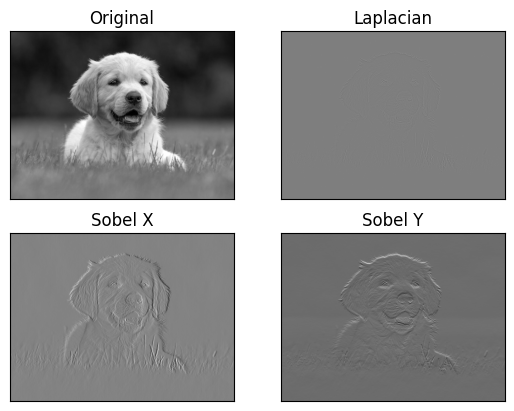

In [21]:
import numpy as np
import cv2 as cv
from matplotlib import pyplot as plt

img = cv.imread('dog.jpg', cv.IMREAD_GRAYSCALE)
assert img is not None, "file could not be read, check with os.path.exists()"

laplacian = cv.Laplacian(img,cv.CV_64F)
sobelx = cv.Sobel(img,cv.CV_64F,1,0,ksize=5)
sobely = cv.Sobel(img,cv.CV_64F,0,1,ksize=5)

plt.subplot(2,2,1),plt.imshow(img,cmap = 'gray')
plt.title('Original'), plt.xticks([]), plt.yticks([])
plt.subplot(2,2,2),plt.imshow(laplacian,cmap = 'gray')
plt.title('Laplacian'), plt.xticks([]), plt.yticks([])
plt.subplot(2,2,3),plt.imshow(sobelx,cmap = 'gray')
plt.title('Sobel X'), plt.xticks([]), plt.yticks([])
plt.subplot(2,2,4),plt.imshow(sobely,cmap = 'gray')
plt.title('Sobel Y'), plt.xticks([]), plt.yticks([])

plt.show()

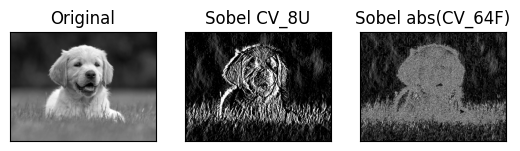

In [22]:
import numpy as np
import cv2 as cv
from matplotlib import pyplot as plt

img = cv.imread('dog.jpg', cv.IMREAD_GRAYSCALE)
assert img is not None, "file could not be read, check with os.path.exists()"

# Output dtype = cv.CV_8U
sobelx8u = cv.Sobel(img,cv.CV_8U,1,0,ksize=5)

# Output dtype = cv.CV_64F. Then take its absolute and convert to cv.CV_8U
sobelx64f = cv.Sobel(img,cv.CV_64F,1,0,ksize=5)
abs_sobel64f = np.absolute(sobelx64f)
sobel_8u = np.uint8(abs_sobel64f)

plt.subplot(1,3,1),plt.imshow(img,cmap = 'gray')
plt.title('Original'), plt.xticks([]), plt.yticks([])
plt.subplot(1,3,2),plt.imshow(sobelx8u,cmap = 'gray')
plt.title('Sobel CV_8U'), plt.xticks([]), plt.yticks([])
plt.subplot(1,3,3),plt.imshow(sobel_8u,cmap = 'gray')
plt.title('Sobel abs(CV_64F)'), plt.xticks([]), plt.yticks([])

plt.show()